# Import Dependencies

In [1]:
!pip install -q albumentations
!pip install -q seaborn
!pip install -q tqdm
!pip install -q numpy
!pip install -q addict
!pip install -q torch


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import torch
from torch import nn
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import Dataset, DataLoader, random_split, SubsetRandomSampler
from torchvision import models
import albumentations as A
from albumentations.pytorch import ToTensorV2
from PIL import Image
import numpy as np
import logging
from addict import Dict
import os
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from datetime import datetime
import random
from urllib.request import urlretrieve
import shutil
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import cv2
from collections import Counter
from sklearn.model_selection import StratifiedShuffleSplit


torch.cuda.is_available()
logging.basicConfig(format="[%(levelname)s] [%(asctime)s] - %(message)s")

In [5]:
torch.cuda.is_available()

True

# Download Dataset

In [3]:
class TqdmUpTo(tqdm):
    def update_to(self, b=1, bsize=1, tsize=None):
        if tsize is not None:
            self.total = tsize
        self.update(b * bsize - self.n)


def download_url(url, filepath):
    directory = os.path.dirname(os.path.abspath(filepath))
    os.makedirs(directory, exist_ok=True)
    if os.path.exists(filepath):
        print("Filepath already exists. Skipping download.")
        return

    with TqdmUpTo(unit="B", unit_scale=True, unit_divisor=1024, miniters=1, desc=os.path.basename(filepath)) as t:
        urlretrieve(url, filename=filepath, reporthook=t.update_to, data=None)
        t.total = t.n


def extract_archive(filepath):
    extract_dir = os.path.dirname(os.path.abspath(filepath))
    shutil.unpack_archive(filepath, extract_dir)

In [5]:
dataset_directory = os.path.join(os.environ["USERPROFILE"], "datasets/")
path = dataset_directory

In [7]:
filepath = os.path.join(dataset_directory, "flower_photos.tgz")
download_url(
    url="https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz",
    filepath=filepath,
)
extract_archive(filepath)

flower_photos.tgz: 100%|██████████| 218M/218M [00:12<00:00, 18.8MB/s]   


# Dataset Loader

In [3]:
class FlowersDataset(Dataset):
    def __init__(self, path:str, shape=(256, 256), augmentations=None):
        self.__images_classes_paths = []
        self.__shape = shape                                                      #crops all images into a defined shape (i.e. 256x256 square)
        self.__augmentations = augmentations                                      #defines the augmentations being used during training, given in config parameter
        self.labels = []                                                          #dataset for each different type of flowers in the dataset
        original_dataset_size = 3670
        print("Reduce dataset by x times:" )
        factor = input()                                                          #input prompt for how many times to reduce the original dataset size by

        if os.path.exists(path):
            self.__path = path
            folders = [_ for _ in os.listdir(self.__path) if _ != "flowers"]

            for folder in folders:
                folder_path = os.path.join(self.__path, folder)
                if os.path.isdir(folder_path) and os.path.exists(folder_path):
                    images = os.listdir(folder_path)
                    self.labels.append(folder)

                    num_images_to_load = len(images) // int(factor)
                    selected_images = random.sample(images, num_images_to_load)


                    if len(selected_images):
                        for image in selected_images:
                            if image.endswith("jpeg") or image.endswith("png") or image.endswith("jpg"):
                                image_path = os.path.join(folder_path, image)
                                self.__images_classes_paths.append((folder, image_path))
                    else:
                        message = f"Images for folder '{folder}' weren't found!"
                        print(message)
                else:
                    message = f"'{folder}' is not folder and it will be skipped!"
                    print(message)

        else:
            message = f"Path '{path}' does not exists!"
            raise Exception(message)

        self.__images_classes_paths = np.array(self.__images_classes_paths)
        current_dataset_size = len(self.__images_classes_paths)
        print("Number of images in dataset:")
        print(len(self.__images_classes_paths))





    def __load_image(self, path, channels="RGB"):
        width, height = self.__shape
        loader = A.Compose([
            A.Resize(width, height),
            ToTensorV2(),
        ])

        image = np.array(Image.open(path).convert(channels))
        return loader(image=image)["image"]                                       #loads and resizes images into 256x256 squares

    def __len__(self):
        return len(self.__images_classes_paths)


    def __getitem__(self, index):
        item = self.__images_classes_paths[index]
        label, image_path = item

        image = self.__load_image(image_path, channels="RGB")

        if self.__augmentations is not None:
            image = self.__augmentations(image=image.permute(1, 2, 0).numpy())["image"] #permute swaps image parameters for use in tensor, and then image is augmented
        
            
        label = self.labels.index(label)                                         #for each image,
        
        
        return Dict({
            "label": label,
            "image": image
        })
        

def create_control_test_dataset(dataset, test_size=734):
    num_classes = len(dataset.labels)
    samples_per_class = test_size // num_classes
    test_indices = []

    for label in range(num_classes):
        indices = np.where(np.array(dataset.labels) == label)[0]
        if len(indices) < samples_per_class:
            raise ValueError(f"Not enough samples for class {label} to create the test dataset.")
        selected_indices = np.random.choice(indices, size=samples_per_class, replace=False)
        test_indices.extend(selected_indices)

    control_test_dataset = [dataset[idx] for idx in test_indices]
    remaining_dataset = [item for idx, item in enumerate(dataset) if idx not in test_indices]
    
    return control_test_dataset, remaining_dataset


# Trainer + Splitter + Other functions

In [27]:
from torch.utils.data import Subset

class Trainer:
    def __init__(self, model, criterion, optimizer, scheduler=None, metric=None, device="cpu", float_precision=3):
        self.__model = model
        self.__criterion = criterion
        self.__optimizer = optimizer
        self.__scheduler = scheduler
        self.__metric = metric
        self.__device = device
        self.logs = Dict({})
        self.float_precision = float_precision
        self.reference_image = None
        self.reference_label = None
        self.epoch_images = []


    def __log(self, logs):
        for k,v in logs.items():
            if k not in self.logs.keys():
                self.logs[k] = []

            self.logs[k].append(v)


    def __make_checkpoint(self, info, path=f"checkpoints/checkpoint.pt"):
        checkpoint_info = {
           **info,
            "optimizer_state": self.__optimizer.state_dict(),
            "model_state": self.__model.state_dict(),
        }

        torch.save(checkpoint_info, path)


    def evaluate(self, loader):
        loss = 0
        length = len(loader)
        with torch.no_grad():
            loop = tqdm(loader)
            loop.set_description("Evaluating")
            for batch in loop:
                torch.cuda.empty_cache()
                images = batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
                labels = batch["labels"].type(torch.cuda.FloatTensor).to("cpu")

                output = self.__model(images).to("cpu")

                batch_loss = criterion(output, labels.long())
                loss += batch_loss.item()

        loss /= length

        return loss

    def save(self, path="model.pt"):
        torch.save(self.__model.state_dict(), path)
        


    def fit(self, loader, epochs=10, validation_loader=None):
        model.to(self.__device)
        train_length = len(loader)

        best_validation_loss = 0
        
        for epoch in range(epochs):
            #display image before epoch start
            reference_batch = next(iter(loader))
            reference_image = reference_batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
            reference_label = reference_batch["labels"].type(torch.cuda.FloatTensor).to("cpu")
            

            float_image1 = reference_image[1].cpu().permute(1, 2, 0).numpy()
            min_val = float_image1.min()
            max_val = float_image1.max()
            float_image1 = (float_image1 - min_val) / (max_val - min_val)
            image1 = (float_image1 * 255).astype(np.uint8)

            self.epoch_images.append(image1)

            epoch_loss = 0

            loop = tqdm(train_loader, position=0, leave=True)
            loop.set_description(f"Epoch [{epoch + 1}/{epochs}]")
            for batch in loop:
                torch.cuda.empty_cache()
                optimizer.zero_grad()

                images = batch["images"].type(torch.cuda.FloatTensor).to(self.__device)
                labels = batch["labels"].type(torch.cuda.FloatTensor).to("cpu")

                output = self.__model(images).to("cpu")
                predicted_class = torch.argmax(output, dim=1)

                loss = self.__criterion(output, labels.long())

                epoch_loss += loss.item()

                loop.set_postfix(loss=loss.item())

                loss.backward()
                optimizer.step()

            epoch_loss /= train_length

            self.__log({"epochs": epoch+1, "train_loss": epoch_loss})
            loop.set_postfix(loss=epoch_loss)
            

            if validation_loader is not None:
                validation_loss = self.evaluate(validation_loader)
                self.__log({"validation_loss": validation_loss})

                rounded_loss = np.round(validation_loss, 3)
                if rounded_loss > best_validation_loss:
                    now = datetime.now().strftime("%H:%M:%S %d.%m.%Y")
                    checkpoint_path = f"{rounded_loss}.pt"

                    checkpoint_info =  {
                        "epoch": epoch+1,
                        "loss": validation_loss
                    }

                    self.__make_checkpoint(info=checkpoint_info, path=checkpoint_path)

                    best_validation_loss = rounded_loss

                if self.__scheduler is not None:
                    self.__scheduler.step(validation_loss)

            else:
                if self.__scheduler is not None:
                    self.__scheduler.step()

            lr = self.__optimizer.defaults["lr"]
            self.__log({"lr": lr})
        
        self.display_images_grid()
    
    def display_images_grid(self):
        rows, cols = 2, 5
        total_images = len(self.epoch_images)
        num_img = min(rows * cols, total_images)
        fig = plt.figure(figsize=(cols * 3, rows *3))
    
        for i in range(num_img):
            ax = fig.add_subplot(rows, cols, i + 1)
            ax.imshow(self.epoch_images[i])
            ax.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    def plot_loss(self):
        if "train_loss" in self.logs and "epochs" in self.logs:
            plt.figure(figsize=(10, 6))
            plt.plot(self.logs["epochs"], self.logs["train_loss"], label='Training Loss')

            if "validation_loss" in self.logs:
                plt.plot(self.logs["epochs"], self.logs["validation_loss"], label='Validation Loss')

            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.title('Loss Per Epoch')
            plt.legend()
            plt.show()
        else:
            print("Training loss not available.")
        



def collate_fn(batch):
    images, labels = [], []

    for item in batch:
        label, image = item.label, item.image.tolist()

        images.append(image)
        labels.append(label)

    return {
        "images": torch.tensor(images),
        "labels": torch.tensor(labels)
    }

def exclude_indices(dataset, indices):
    return Subset(dataset, [i for i in range(len(dataset)) if i not in set(indices)])

def train_test_strat(dataset):
    test_size = 734
    reduction_factor = int(input("Specify the reduction factor:"))
    
    features = [item["image"] for item in dataset]
    labels = [item["label"] for item in dataset]
    
    sss = StratifiedShuffleSplit(n_splits=10, test_size=test_size, random_state=10)
    train_index, test_index = next(sss.split(features, labels))
    
    test_data = [dataset[i] for i in test_index]
    train_data = exclude_indices(dataset, test_index)
    
    use_size = round(len(train_data) // reduction_factor)
    discard_size = len(train_data) - use_size
    use_data, discard_data = random_split(train_data, [use_size, discard_size])
    
    print(f"Train Images: {len(use_data)}")
    print(f"Test Images: {len(test_data)}")
    
    return use_data, test_data

def train_test_random(dataset):
    test_size = 734
    reduction_factor = int(input("Specify the reduction factor:"))
    length = len(dataset)
    train_size = length - test_size
    use_size = round(train_size // reduction_factor)
    discard_size = train_size - use_size

    train_dataset, test_dataset = random_split(dataset, [train_size, test_size])
    use_dataset, discard_dataset = random_split(train_dataset, [use_size, discard_size])
    
    print(f"Train Images: {len(use_dataset)}")
    print(f"Test Images: {len(test_dataset)}")
    
    return use_dataset, test_dataset

# Config

In [5]:
config = Dict({
    "path": "C:/Users/JCHAN087/datasets/flower_photos/",
    "device": torch.device("cuda" if torch.cuda.is_available() else "cpu"),
    "batch_size": 16,
    "augmentations": A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.2),
        A.Rotate(limit=45, p=0.5),
        A.RandomFog(fog_coef_lower=0.1, fog_coef_upper=0.5, alpha_coef=0.05, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.RandomGamma(gamma_limit=(50, 150), p=0.4),
        A.RandomBrightness(p=0.4),
        A.OpticalDistortion(p=0.2),
        A.Blur(blur_limit=2, p=0.2),
        ToTensorV2(),
    ]),
    "num_workers": 0,
})

C:\Users\JCHAN087\PycharmProjects\pythonProject2\.venv\Lib\site-packages\albumentations\augmentations\transforms.py:1258: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  warnings.warn(


# Load Dataset

In [6]:
dataset = FlowersDataset(path=config.path, augmentations=config.augmentations)

Reduce dataset by x times:
Number of images in dataset:
3670


C:\Users\JCHAN087\AppData\Local\Temp\ipykernel_22788\3198388625.py:15: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


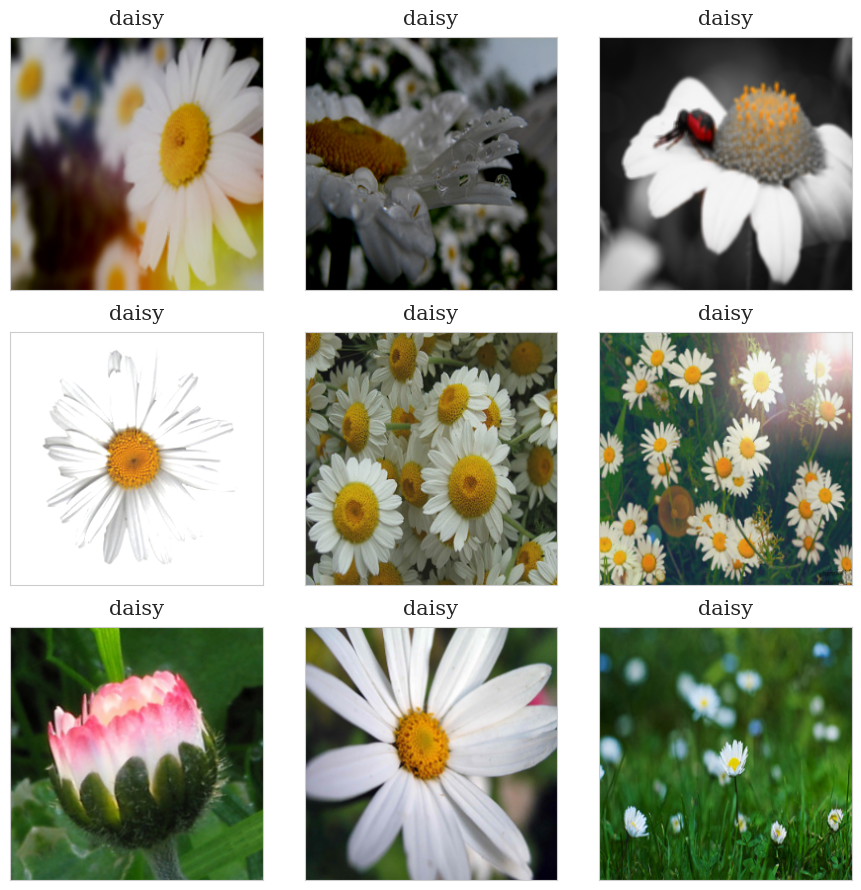

In [7]:
rows, cols = 3, 3
fig = plt.figure(figsize=(cols*3, rows*3))
for _ in range(rows * cols):
    item = dataset[_*50]
    label = item.label
    class_ = dataset.labels[label]
    image = item.image.permute(1, 2, 0).numpy()
    ax = fig.add_subplot(rows, cols, _+1)
    ax.imshow(image)
    ax.set_title(class_, fontsize=15, fontfamily="serif", y=1.02)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)

fig.tight_layout()
fig.show()

In [8]:
train_data, test_data = train_test_strat(dataset)

Train Images: 2936
Test Images: 734


C:\Users\JCHAN087\AppData\Local\Temp\ipykernel_22788\1815632522.py:12: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


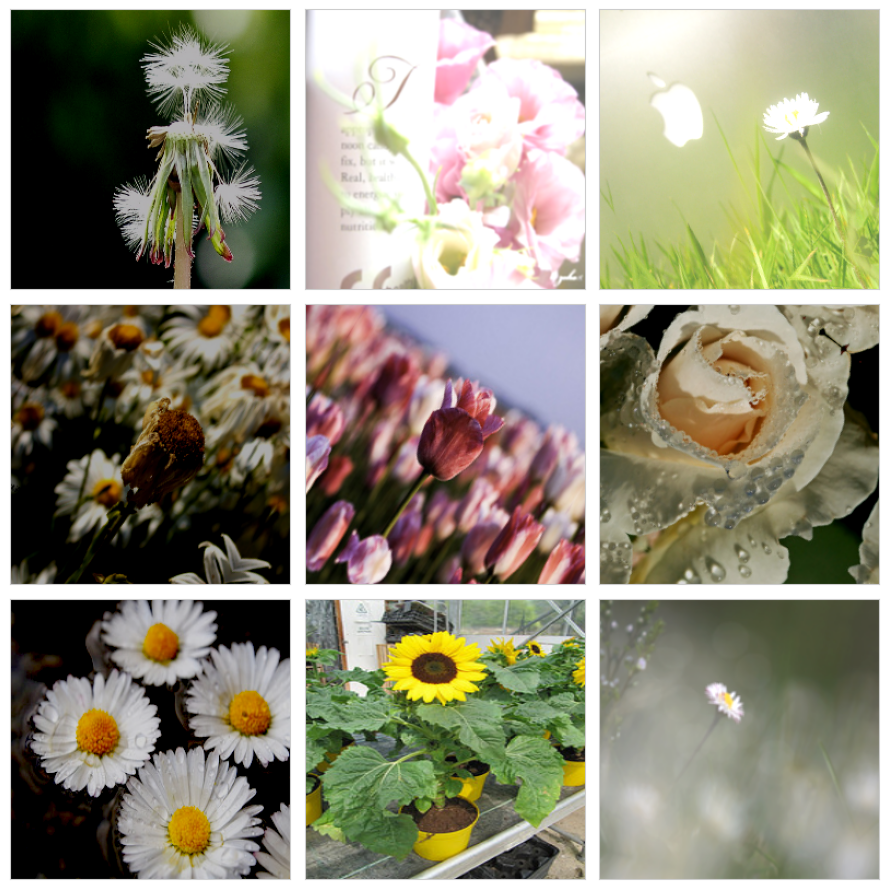

In [9]:
rows, cols = 3, 3
fig = plt.figure(figsize=(cols*3, rows*3))
for _ in range(rows * cols):
    item = test_data[_*50]
    image = item.image.permute(1, 2, 0).numpy()
    ax = fig.add_subplot(rows, cols, _+1)
    ax.imshow(image)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)

fig.tight_layout()
fig.show()

In [10]:
train_data2, test_data2 = train_test_strat(dataset)

Train Images: 293
Test Images: 734


C:\Users\JCHAN087\AppData\Local\Temp\ipykernel_22788\4233265086.py:12: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


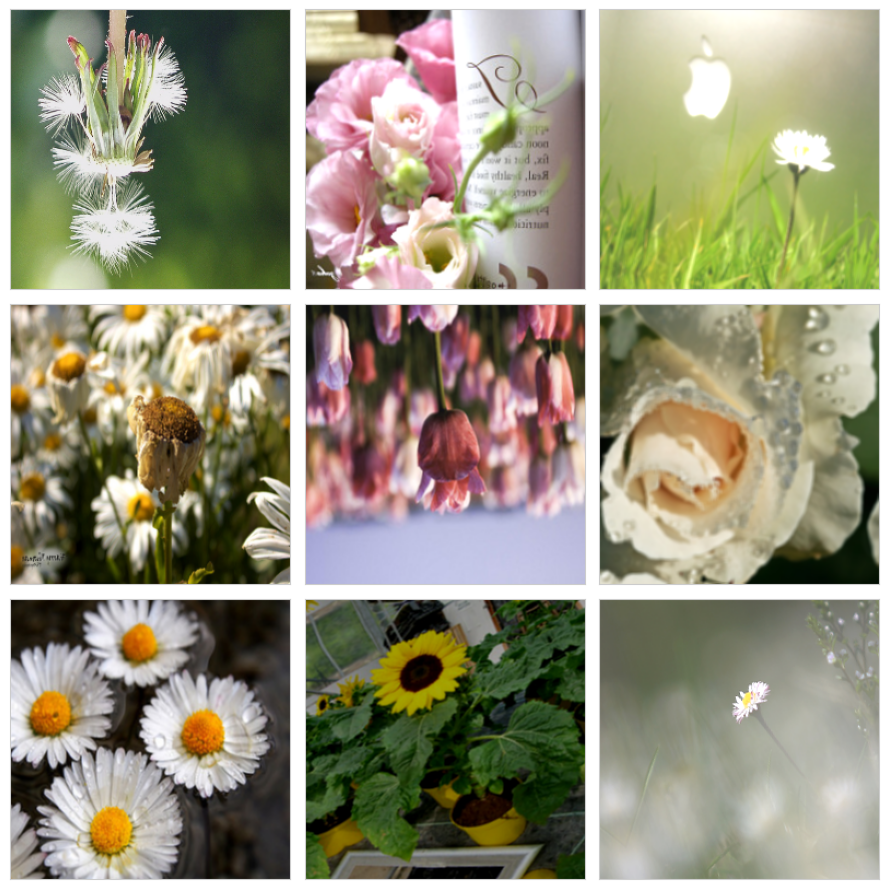

In [11]:
rows, cols = 3, 3
fig = plt.figure(figsize=(cols*3, rows*3))
for _ in range(rows * cols):
    item = test_data2[_*50]
    image = item.image.permute(1, 2, 0).numpy()
    ax = fig.add_subplot(rows, cols, _+1)
    ax.imshow(image)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)

fig.tight_layout()
fig.show()

In [12]:
from torch.utils.data import RandomSampler
train_sampler = RandomSampler(train_data2)

In [13]:
train_loader = DataLoader(train_data2,
                          batch_size=config.batch_size,
                          shuffle=False,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data2,
                         batch_size=config.batch_size*2,
                         shuffle=False,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [14]:
model = models.resnet50(weights="DEFAULT")

In [14]:
torch.cuda.is_available()

True

Proof of Augmentation

Evaluating: 100%|██████████| 23/23 [00:28<00:00,  1.22s/it]


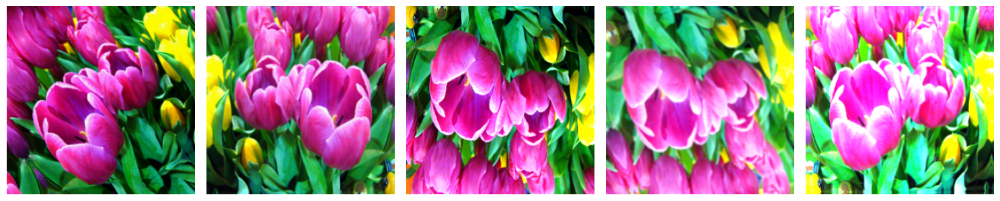

In [15]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=5)

Test on 100% Size, 1 Epoch

In [115]:
train_data, test_data = train_test_strat(dataset)

Train Images: 2936
Test Images: 734


In [17]:
from torch.utils.data import SequentialSampler

sampler = SequentialSampler(train_data)

In [18]:
train_loader = DataLoader(train_data,
                          batch_size=config.batch_size,
                          sampler=sampler,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data,
                         batch_size=config.batch_size*2,
                         shuffle=False,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [19]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.21s/it]


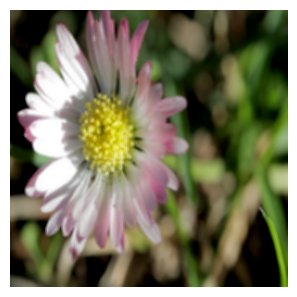

In [20]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=1)

C:\Users\JCHAN087\AppData\Local\Temp\ipykernel_22788\604069031.py:28: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


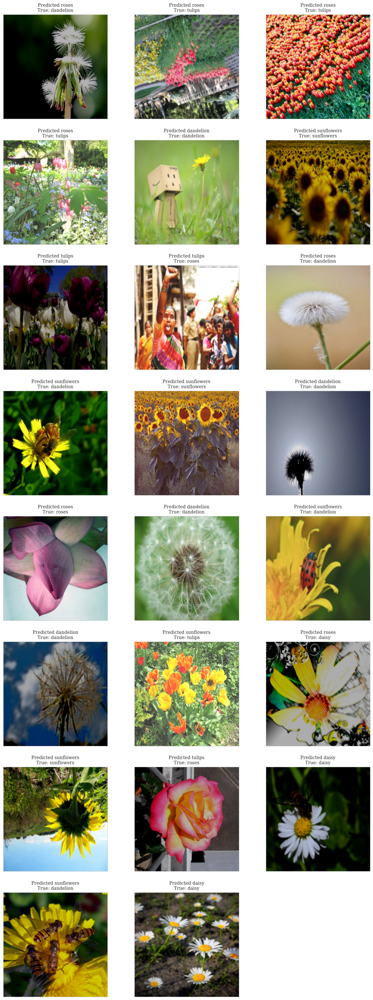

In [21]:
all_predicted_labels = []
all_true_labels = []

fig = plt.figure(figsize=(3*5, 10*5))
model.to(config.device)
model.eval()
with torch.no_grad():
    for idx, batch in enumerate(test_loader):
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1)

        ax = fig.add_subplot(10, 3, idx+1)
        normalized_images = images / 255.0
        float_image = normalized_images[0].cpu().permute(1, 2, 0).numpy()
        float_image = (float_image * 255).astype(np.uint8)
        ax.imshow(float_image)
        ax.set_title(f"Predicted {dataset.labels[predicted_label[0]]}\nTrue: {dataset.labels[labels[0]]}", fontsize=10, fontfamily="serif")
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

fig.show()

In [22]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

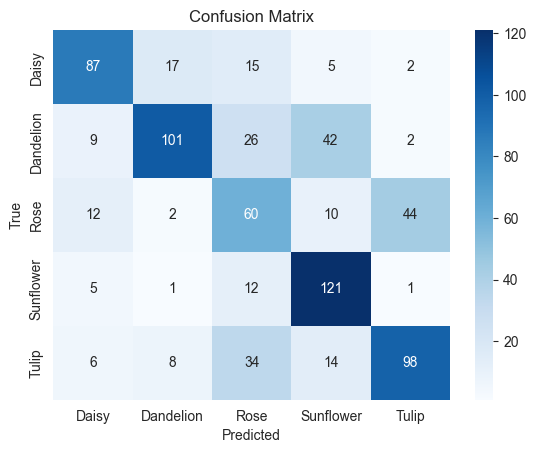

Classification Accuracy: 63.62%


In [23]:
class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

100% Data Size, 10 Epochs

In [24]:
sampler = SequentialSampler(train_data)
train_loader = DataLoader(train_data,
                          batch_size=config.batch_size,
                          sampler=sampler,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data,
                         batch_size=config.batch_size*2,
                         shuffle=False,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [25]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.19s/it]


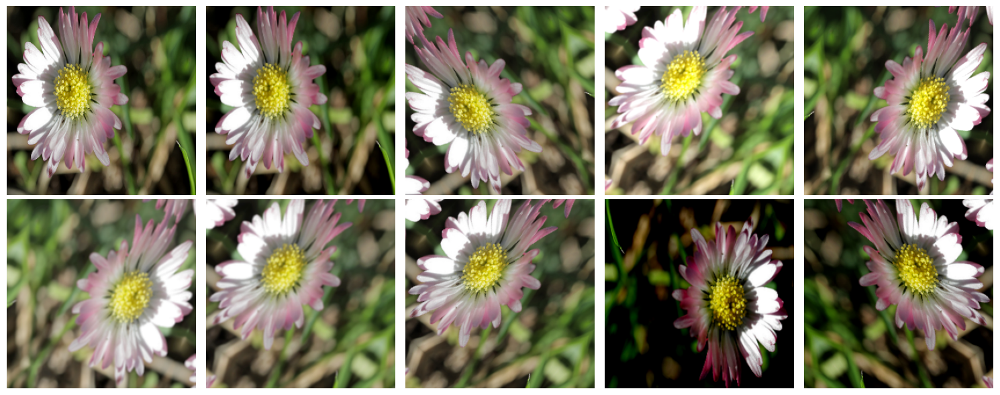

In [28]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=10)

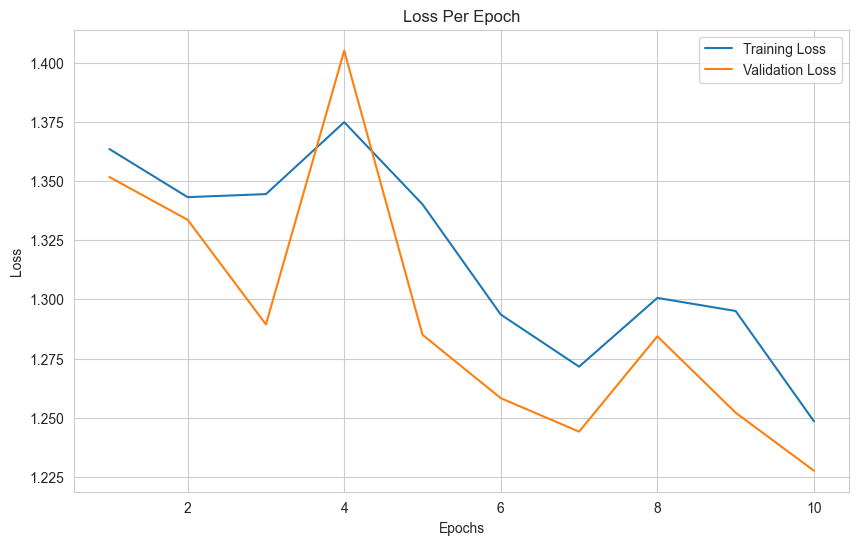

In [29]:
trainer.plot_loss()

In [30]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

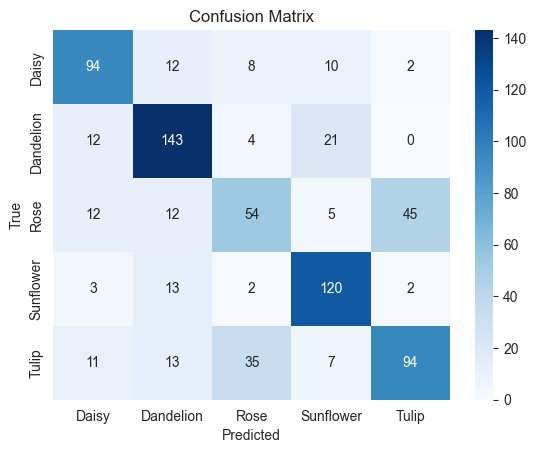

Classification Accuracy: 68.80%


In [31]:
class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

10% Dataset Size, 10 Epochs

In [59]:
train_data2, test_data2 = train_test_strat(dataset)

Train Images: 293
Test Images: 734


In [65]:
sampler2 = RandomSampler(train_data2)
train_loader = DataLoader(train_data2,
                          batch_size=config.batch_size,
                          sampler=sampler2,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data2,
                         batch_size=config.batch_size*2,
                         shuffle=False,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [66]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:28<00:00,  1.24s/it]


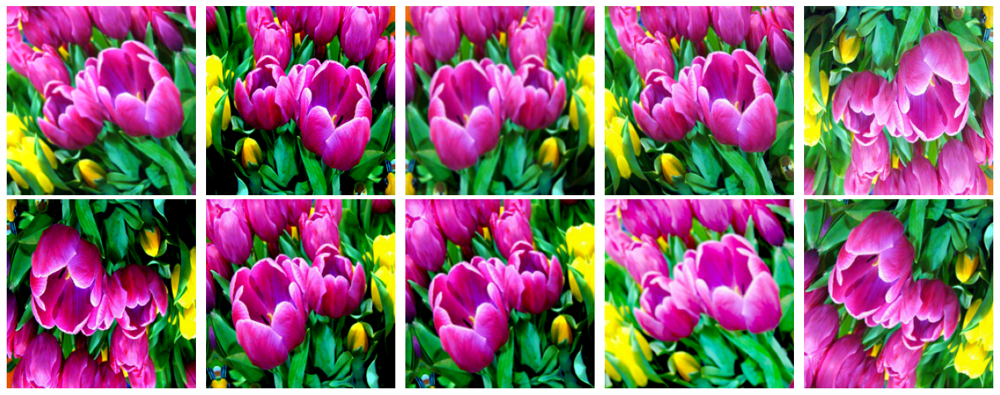

In [38]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=10)

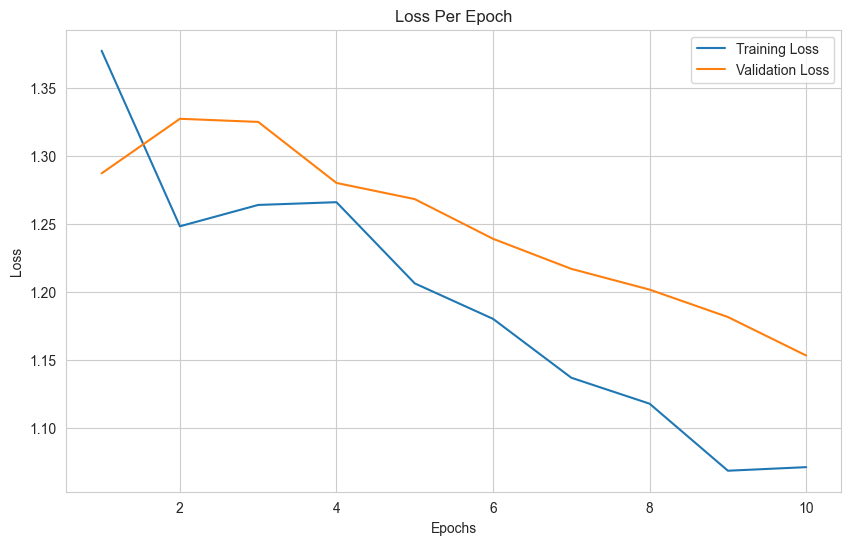

In [39]:
trainer.plot_loss()

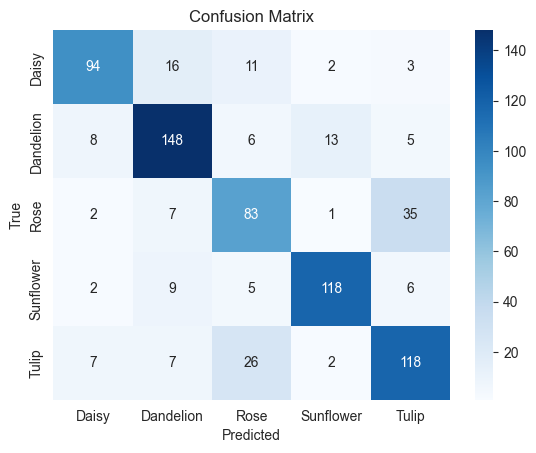

Classification Accuracy: 76.43%


In [40]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

10% Dataset Size, 50 Epochs

In [67]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:29<00:00,  1.28s/it]


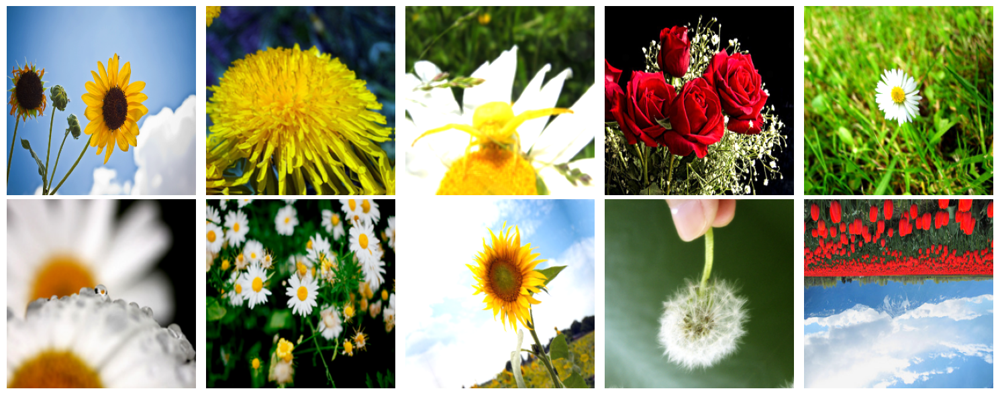

In [68]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=50)

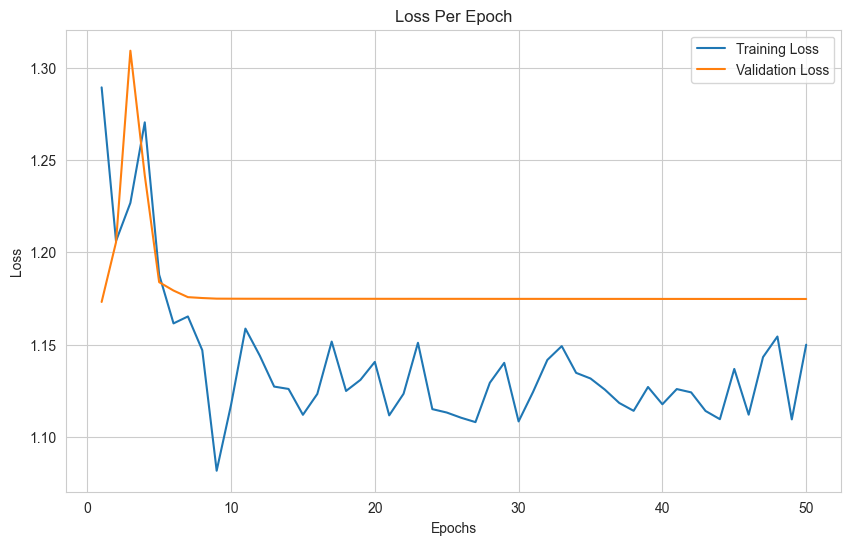

In [69]:
trainer.plot_loss()

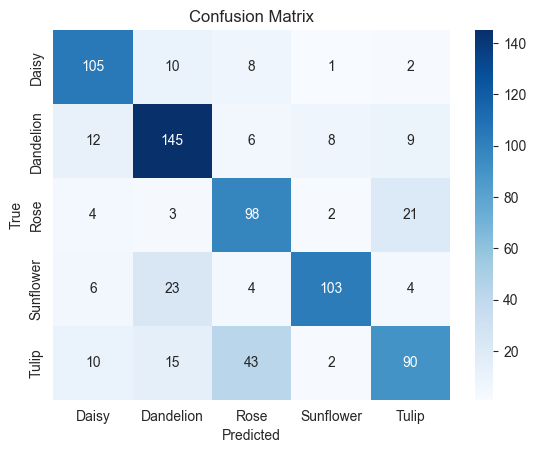

Classification Accuracy: 73.71%


In [70]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

10% Dataset Size, 100 Epochs

In [41]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:28<00:00,  1.24s/it]


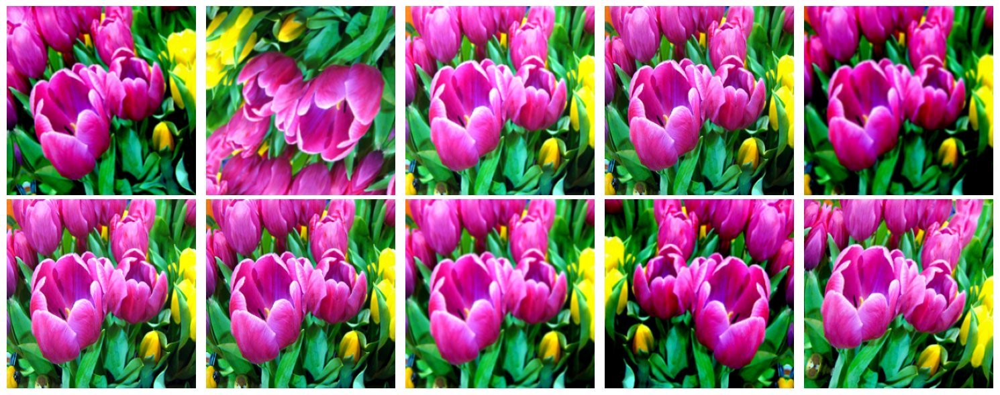

In [42]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)

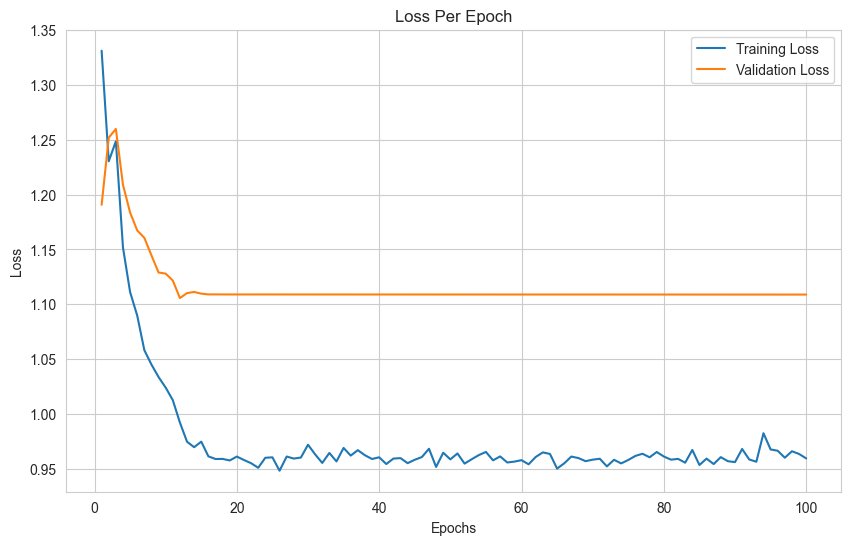

In [43]:
trainer.plot_loss()

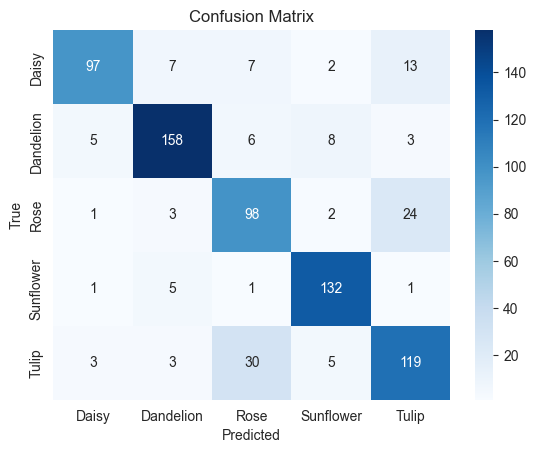

Classification Accuracy: 82.29%


In [44]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

1% Dataset Size, 10 Epochs

In [71]:
train_data3, test_data3 = train_test_strat(dataset)

Train Images: 29
Test Images: 734


In [72]:
sampler3 = SequentialSampler(train_data3)
train_loader = DataLoader(train_data3,
                          batch_size=config.batch_size,
                          sampler=sampler3,
                          num_workers=config.num_workers,
                          pin_memory=True,
                          collate_fn=collate_fn
                          )


test_loader = DataLoader(test_data3,
                         batch_size=config.batch_size*2,
                         shuffle=False,
                         num_workers=config.num_workers,
                         pin_memory=True,
                         collate_fn=collate_fn
                         )

In [50]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.20s/it]


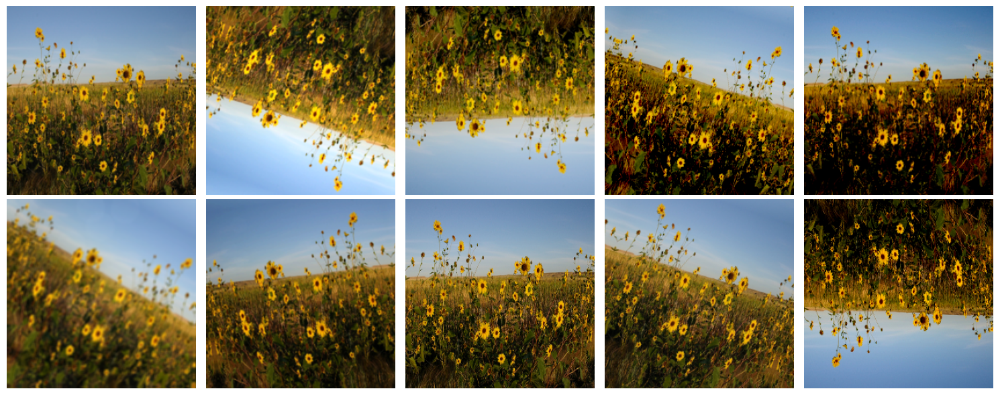

In [52]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=10)

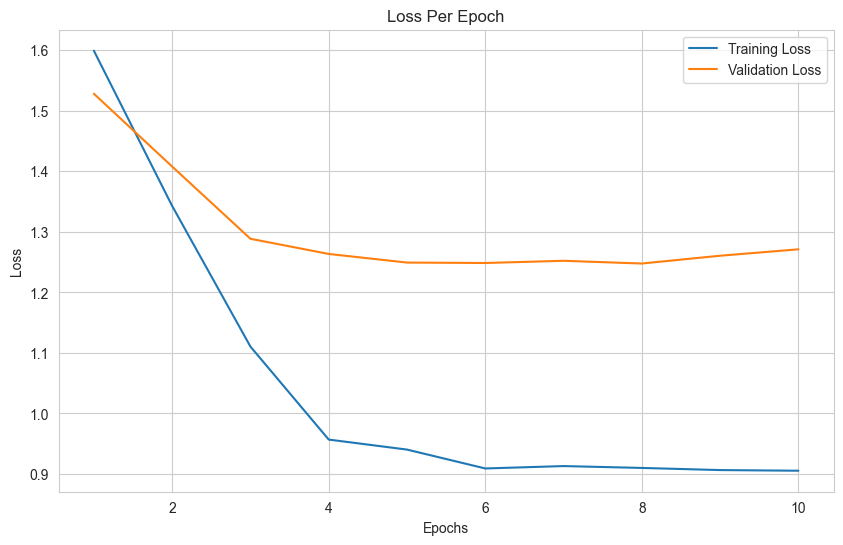

In [53]:
trainer.plot_loss()

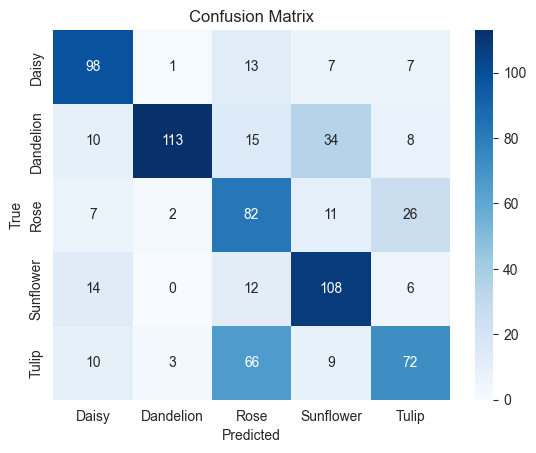

Classification Accuracy: 64.44%


In [54]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

1% Dataset Size, 50 Epochs

In [55]:
model = models.resnet50(weights="DEFAULT")

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.21s/it]


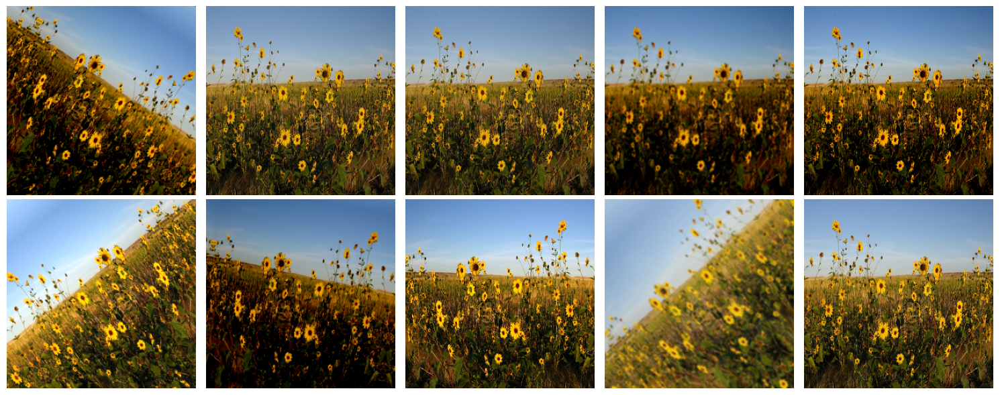

In [56]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=50)

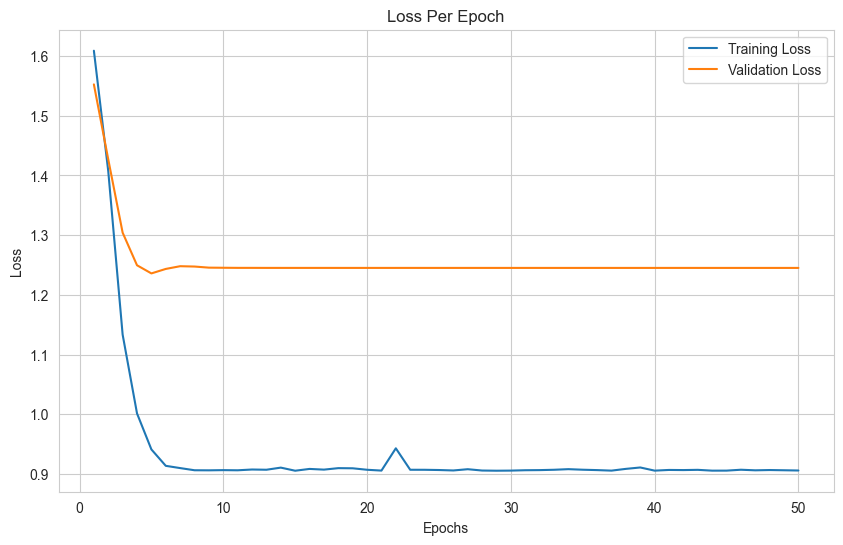

In [57]:
trainer.plot_loss()

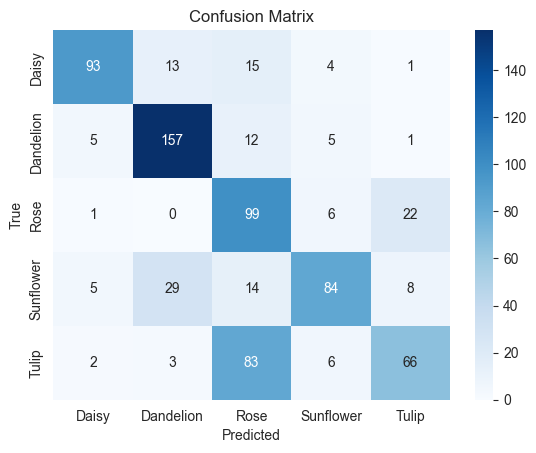

Classification Accuracy: 67.98%


In [58]:
all_predicted_labels = []
all_true_labels = []

model.to(config.device)
model.eval()

with torch.no_grad():
    for batch in test_loader:
        torch.cuda.empty_cache()

        images = batch["images"].type(torch.cuda.FloatTensor).to(config.device)
        labels = batch["labels"].to("cuda")

        output = model(images).to("cuda")
        predicted_label = torch.argmax(output, dim=1).cpu().numpy()

        all_predicted_labels.extend(predicted_label)
        all_true_labels.extend(labels.cpu().numpy())

predicted_labels_array = np.array(all_predicted_labels)
true_labels_array = np.array(all_true_labels)

confusion = confusion_matrix(true_labels_array, predicted_labels_array)

accuracy = accuracy_score(true_labels_array, predicted_labels_array)

class_names = ["Daisy", "Dandelion", "Rose", "Sunflower", "Tulip"]

sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

accuracy_full = accuracy

print("Classification Accuracy: {:.2%}".format(accuracy))

1% Dataset Size, 100 Epochs

In [73]:
model = models.resnet50(weights="DEFAULT")

In [ ]:
for parameter in model.parameters():
    parameter.require_grad = False

classifier = nn.Sequential(
    nn.Linear(in_features=2048, out_features=5),
    nn.Softmax(dim=1),
)
model.fc = classifier

optimizer = AdamW(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
scheduler = ReduceLROnPlateau(optimizer, patience=1)

trainer = Trainer(model=model, criterion=criterion, optimizer=optimizer, scheduler=scheduler, device=config.device)
trainer.fit(train_loader, validation_loader=test_loader, epochs=100)

Evaluating:  35%|███▍      | 8/23 [00:09<00:18,  1.20s/it]